In [1]:
from bs4 import BeautifulSoup
import requests
import pandas as pd
import numpy as np
import math
import seaborn as sns
import matplotlib.pyplot as plt

## Loading the dataset and parsing it

In [2]:
with open('../files/hw2-patients.xml') as patients_xml_file:
    data = BeautifulSoup(patients_xml_file,'lxml')
data


<html><body><patientdata>
<generated author="McDougal" date="2021-09-19"></generated>
<institution>Imaginary Hospital System</institution>
<patients>
<patient age="19.529988374393394" gender="female" name="Tammy Martin">
</patient>
<patient age="1.6021974892211832" gender="female" name="Lucy Stribley">
</patient>
<patient age="19.317022680802072" gender="male" name="Albert Trevino">
</patient>
<patient age="79.44120768829171" gender="male" name="Troy Armour">
</patient>
<patient age="71.20386333449743" gender="male" name="Jose Masseria">
</patient>
<patient age="77.30270711879035" gender="female" name="Ethel Ferdinand">
<diagnosis>Hypertension</diagnosis>
</patient>
<patient age="4.246844166003803" gender="female" name="Elizabeth Heflin">
<testresults>
<weight date="2021-09-18" units="kg">19</weight>
</testresults>
</patient>
<patient age="24.334513846211735" gender="female" name="Jesica Gautier">
</patient>
<patient age="26.513040128614485" gender="female" name="Marta Allen">
<diagnos

## Number of patients

In [3]:
patient_list = list(data.patients.find_all('patient'))
len(patient_list)

324357

## Create a list of patient attributes and convert it to a pandas dataframe 

In [4]:
patient_list_attrs = [patient.attrs for patient in patient_list]
df = pd.DataFrame(patient_list_attrs)
df

,age,gender,name
0,19.529988374393394,female,Tammy Martin
1,1.6021974892211832,female,Lucy Stribley
2,19.317022680802072,male,Albert Trevino
3,79.44120768829171,male,Troy Armour
4,71.20386333449743,male,Jose Masseria
...,...,...,...
324352,60.955354683739515,male,Jeremy Brode
324353,22.676277067197912,female,Lynda Brown
324354,64.46637770677887,female,Joyce Adkins
324355,56.770128136616805,male,Kevin Hensley


In [5]:
# Typecasting age column to float
df['age'] = df['age'].astype('float')

## Plot the histogram of ages at various levels of granularity

<AxesSubplot:xlabel='age', ylabel='Count'>

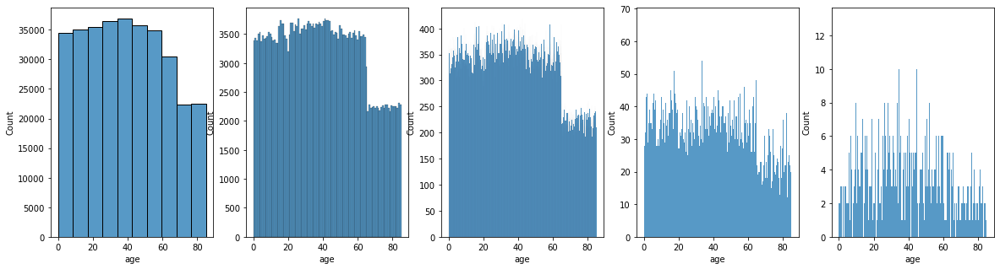

In [8]:
figure,ax = plt.subplots(1,5,figsize = (20,5))
sns.histplot(df['age'],bins = 10,ax=ax[0])
sns.histplot(df['age'],bins = 100,ax=ax[1])
sns.histplot(df['age'],bins = 1000,ax=ax[2])
sns.histplot(df['age'],bins = 10000,ax=ax[3])
sns.histplot(df['age'],bins = 100000,ax=ax[4])

## Checking whether each patient has a unique age

In [6]:
# groupby age should reveal ages which have multiple counts
df_counts_age = df.groupby(['age']).count()
df_counts_age

,gender,name
age,,
0.000106,1,1
0.000861,1,1
0.001194,1,1
0.002248,1,1
0.002581,1,1
...,...,...
84.997240,1,1
84.997943,1,1
84.998202,1,1


## Since an empty set is returned when queried for row with gender count > 1, all ages are unique

In [7]:
df_counts_age[df_counts_age['gender'] != 1]
### Thus everyone has a unique age in the dataframe

,gender,name
age,,


## Unique gender categories, counts and histplots

In [8]:
df['gender'].unique()
# The provider has encoded gender as string with categories female, male and unknown

array(['female', 'male', 'unknown'], dtype=object)

158992
165293


<AxesSubplot:xlabel='gender', ylabel='Count'>

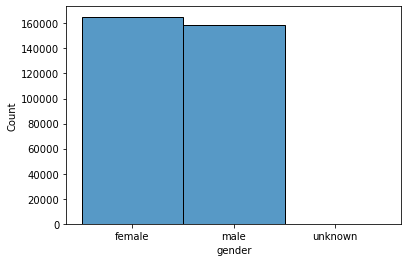

In [9]:
print(len(df[df['gender'] == 'male']))
print(len(df[df['gender'] == 'female']))
sns.histplot(df['gender'])

## Sorting values in dataframe

In [10]:
df.sort_values('age')

,age,gender,name
310783,0.000106,male,Timothy Larson
116120,0.000861,female,Lisa Dercole
288755,0.001194,female,Julia Clinton
320248,0.002248,male,Mauricio Pepin
224761,0.002581,male,Peter Blalock
...,...,...,...
41737,84.997240,male,Stephan Yeargin
218995,84.997943,male,Michael Ali
183115,84.998202,female,Tracy Walker
253020,84.998293,male,Raymond Leigh


## Monica Caponera is the oldest patient at 84.998557

## Implementing Quicksort as nlogn native sorting algorithm

In [62]:
# Write a method that swaps values at particular indices
def swap(arr_,i,j):
    if(i == j):
        return
    else:
        # arr_[i] = arr_[i] + arr_[j]
        # arr_[j] = arr_[i] - arr_[j]
        # arr_[i] = arr_[i] - arr_[j]
        arr_[i],arr_[j] = arr_[j],arr_[i]
    return
# Write method to partition
def partition(arr_,st_idx,end_idx):
    # step 1: get the first value in the right place
    val_1 = arr_[st_idx]
    idx_2_ = 0 
    for i in range(st_idx+1,end_idx + 1):
        if(arr_[i]<= val_1):
            idx_2_+=1
    #print(idx_2_)
    idx_2 = st_idx + idx_2_
    swap(arr_,st_idx,idx_2)
    # step 2: set an index i at zeroth position and index j at last position of array, if arr_[i] > arr[val2_idx],pause i and if arr_[j] < arr[val2_idx], stop j, then swap and keep doing this, stop when i >= j

    idx_1  = st_idx
    
    idx_3 = end_idx
    #print(arr_)

    while(idx_1<idx_3):
        if(arr_[idx_1]<=arr_[idx_2]):
            idx_1+=1
        if(arr_[idx_3]>=arr_[idx_2]):
            idx_3-=1
        if((arr_[idx_1]>arr_[idx_2]) & (arr_[idx_3]<arr_[idx_2])):
            swap(arr_,idx_1,idx_3)
            idx_1+=1
            idx_3-=1
         
    return idx_2

# Write method for quicksort

def quicksort(arr_,st_idx,end_idx):
    
    if((len(arr_)<=1)|(st_idx>=end_idx)):
        return
    
    idx_partition = partition(arr_,st_idx,end_idx)

    quicksort(arr_,st_idx,idx_partition-1)
   
    quicksort(arr_,idx_partition+1,end_idx)
    

arr_ = [1,2,3,4,5,6,7,8,9,10]
quicksort(arr_,0,9)
arr_


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

## Just to try our quicksort on our ages we create a dictionary of ages and indices and run this on keys of that dictionary

In [14]:
age_dic = dict(zip(df['age'],df.index))

In [64]:
import random
age_list_sample = list(age_dic.keys())

age_list_sample

[6.19195704656269,
 32.12617601354435,
 26.767343886354272,
 55.34061945259553,
 68.0278438302387,
 31.57274918587693,
 1.202979873821652,
 24.87319830926571,
 60.72202476546459,
 63.548733407031264,
 56.63865373868802,
 14.779637050726592,
 47.57071312268769,
 33.751485108374645,
 11.831914274454974,
 57.29272127962781,
 52.15097881611414,
 84.75202186009868,
 68.9382209404101,
 19.382686534326975,
 43.49069217645027,
 18.382804056438353,
 30.079210224469808,
 36.427637697733516,
 71.11782981601071,
 3.005039010138788,
 71.40557842832949,
 79.4491585434544,
 56.08106960793155,
 68.08313619387421,
 39.68340368284362,
 16.910143848830913,
 35.03361692168026,
 23.079531920430675,
 75.0897228771374,
 61.54190477235102,
 25.36709043262221,
 35.87891345386345,
 43.24576848740087,
 42.21715483218963,
 51.766863244843464,
 35.643808833884464,
 31.37876202249824,
 79.40691596174345,
 27.07719942282942,
 36.99557491631161,
 18.636113781882475,
 48.238349789997926,
 28.031401245228487,
 60.71707

## Note: The insertion sort has worst case time complexity of O(n^2) for sorted lists. Further if we invoke my method on a relatively larger list it will go into the recursive stack overflow, This is an issue that needs to be fixed. Need to ask Dr. McDougal for possible solutions. For now have added a shuffle method so as to not break it. A possible solution is to possibly change recursion limits for python.

In [66]:
#age_list_sample = list(age_dic.keys())
#age_list_sample = [100 - 0.5*i for i in range(100)]
random.shuffle(age_list_sample)
print(type(age_list_sample[0]))
quicksort(age_list_sample,0,len(age_list_sample)-1)
age_list_sample

<class 'float'>


[0.00010629282758800596,
 0.0008606743639882897,
 0.0011937231038899876,
 0.0022482004795970623,
 0.0025810199881115548,
 0.0034623106935055548,
 0.003525418257868118,
 0.003675155813744335,
 0.0037343175432164033,
 0.0037599777579760962,
 0.00397650207045408,
 0.003979967658447325,
 0.004091950387630217,
 0.004637558717756063,
 0.004741426728230302,
 0.004764207679587296,
 0.005062958322389899,
 0.005732221159597817,
 0.005773593475121297,
 0.005829191798066846,
 0.006094777924709471,
 0.006523661955504245,
 0.006704049335342632,
 0.00714862097343727,
 0.0072507397271304175,
 0.007957785056807998,
 0.008419993992216934,
 0.008537360665283877,
 0.008544807669512156,
 0.008593285817687923,
 0.008737336100466675,
 0.008857874989228742,
 0.00947145276009198,
 0.009738541029959413,
 0.00974223787923778,
 0.01014957219222068,
 0.010286458354510919,
 0.010719690743609123,
 0.01088793979395597,
 0.012027488484512294,
 0.012064783462441553,
 0.012914746302395419,
 0.013152367802193865,
 0.0131

## For purposes of our analysis though we will stick to sorting values in the df using sort_values in pandas, we reset the index but also not discard the original index in a column just as a reference to the last df

In [24]:
df.sort_values('age',inplace=True)
# retain old index and add a new one as well
df.reset_index(inplace=True)

## Implementing Native Binary Search, obj_arr is a parameter to run this on our array of person objects later. For running on lists of ages its kept false. The Binary Search returns a tuple of a boolean and index. If True, exact index returned, if False j is returned. The j is required in the age range problem.

In [118]:
def binarySearch(arr,i,j,val,obj_arr = False):
    while((i<=j) & (i<len(arr)) & (j>-1)):
        avg_idx = int((i + j)/2)
        
        if(not obj_arr):
            avg = arr[avg_idx]
        else:
            avg = arr[avg_idx]._age
    
        
        if(abs(avg - val) < 1e-10):
            return True,avg_idx
        elif(avg > val):
            j = avg_idx-1
        else:
            i = avg_idx+1
        
    return False,j
    

#### Testing the Binary Search

In [26]:
sample = [2,3,3,5,6,7,8,9,10,11,13,13,14]
end_idx_lst = len(age_list_sample) - 1
end_idx_smpl = len(sample) - 1
binarySearch(sample,0,end_idx_smpl,10)

(True, 8)

#### Create list of ages to run and test our Binary Search algorithm

In [30]:
ages = list(df['age'])

#### Just checking the dataframe for age values greater than or equal to 41.5 yrs and the length of the dataframe 

In [28]:
df[df['age'] >= 41.5]

,index,age,gender,name
173886,939,41.500000,male,John Braswell
173887,278637,41.500035,female,Toni Jensen
173888,181525,41.500351,male,Michael Brown
173889,124602,41.500619,male,Kevin Addison
173890,180585,41.500738,female,Adeline Scholler
...,...,...,...,...
324352,41737,84.997240,male,Stephan Yeargin
324353,218995,84.997943,male,Michael Ali
324354,183115,84.998202,female,Tracy Walker
324355,253020,84.998293,male,Raymond Leigh


#### The Binary Search returns index in list where 41.5 found

In [31]:
ele_last_idx = len(ages) - 1
(present,idx) = binarySearch(ages,0,ele_last_idx,41.5)
idx

173886

## Patient name is John Braswell. Details of patient in code cell below.

In [32]:
df.iloc[173886]

index               939
age                41.5
gender             male
name      John Braswell
Name: 173886, dtype: object

In [33]:
print(f'patients older than {41.5} years are {ele_last_idx - idx}')

patients older than 41.5 years are 150470


## Write Method for age ranges. high idx and low idx adjusted to account for at least x years old and strictly less than y years old. Here the Binary Search return j is important since when not found it settles on the higher val

#### Can run tests using code in lines 16 through 43

In [164]:
def getNumRanges(arr_,low_range,high_range,obj_arr = False):
    arr_last_idx = len(arr_) - 1
    chk_low,idx_low = binarySearch(arr_,0,arr_last_idx,low_range,obj_arr = obj_arr)
    if(not chk_low):
        idx_low+=1
    chk_high,idx_high = binarySearch(arr_,0,arr_last_idx,high_range,obj_arr = obj_arr)
    if(chk_high):
        idx_high-=1 # This is strictly less than higher bound
    if(obj_arr):
        return idx_low,idx_high,idx_high-idx_low+1,arr_[idx_high - 1].numMales - arr_[idx_low].numMales+1 # Return low index, high index, difference between indices and number of males

    return idx_low,idx_high,idx_high-idx_low+1 # Return low index, high index and difference


#print(sample)
### Running tests
ages_r1 = np.random.uniform(0,84,[100])
ages_r2 = np.random.uniform(0,84,[100])

for i in range(100):
    a_low = min(ages_r1[i],ages_r2[i])
    a_high = max(ages_r1[i],ages_r2[i])
    #print(a_low,a_high)
    low_idx,high_idx,num_people = getNumRanges(age_list_sample,a_low,a_high)
    
    df_control = df[(df['age']>=a_low) & (df['age']<a_high)]
    control_val = len(df_control)
    control_idx_min = df_control.index[0]
    control_idx_max = df_control.index[-1]
    # printing 5 sample va;ues
    if(i<5):
        print("low index",low_idx,"high index",high_idx,"number of people",num_people)
        print("Now using pandas methods for querying") 
        print(control_idx_min,control_idx_max,control_val)
    # raise Exception and break if a single test doesn't succeed
    if (control_val!=num_people) or (control_idx_min!=low_idx) or (control_idx_max!=high_idx):
        print("age_low",a_low)
        print("age_high",a_high)
        print("**** custom method *****")
        print("low_idx",low_idx,"high_idx",high_idx,"number of people",num_people)
        print("**** pandas method *****")
        print("low_idx",control_idx_min,"high_idx",control_idx_max,"number of people",control_val)
        raise Exception('**** values dont match ****')
        
    else:
        pass

    

low index 138672 high index 280054 number of people 141383
Now using pandas methods for querying
138672 280054 141383
low index 280668 high index 319752 number of people 39085
Now using pandas methods for querying
280668 319752 39085
low index 31007 high index 161677 number of people 130671
Now using pandas methods for querying
31007 161677 130671
low index 39400 high index 256254 number of people 216855
Now using pandas methods for querying
39400 256254 216855
low index 25925 high index 87161 number of people 61237
Now using pandas methods for querying
25925 87161 61237


In [157]:
df.iloc[324356]

index               124560
age              84.998557
gender              female
name       Monica Caponera
males               158992
females             165293
other                   72
Name: 324356, dtype: object

## Write a method to be applied to pandas dataframe age column to give corresponding counts of males, females and other so far in the dataset. Could have used pd cumsum() to achieve the same but went through with this anyway.

In [35]:

def get_num_males(gender_):
    global count_males
    global count_females
    global count_other
    if(gender_ == 'male'):
        count_males = count_males +1
    elif(gender_ == 'female'):
        count_females+=1
    else:
        count_other+=1
    return count_males,count_females,count_other

In [36]:
count_males  = 0
count_females = 0
count_other = 0
df_counts = pd.DataFrame()
df_counts[['males','females','other']] = pd.DataFrame(df.gender.apply(get_num_males).tolist())
df = pd.concat([df,df_counts],axis = 1)

#### Here number of males, females and unknown are added as row values to the dataframe

In [96]:
df

,index,age,gender,name,males,females,other
0,310783,0.000106,male,Timothy Larson,1,0,0
1,116120,0.000861,female,Lisa Dercole,1,1,0
2,288755,0.001194,female,Julia Clinton,1,2,0
3,320248,0.002248,male,Mauricio Pepin,2,2,0
4,224761,0.002581,male,Peter Blalock,3,2,0
...,...,...,...,...,...,...,...
324352,41737,84.997240,male,Stephan Yeargin,158990,165291,72
324353,218995,84.997943,male,Michael Ali,158991,165291,72
324354,183115,84.998202,female,Tracy Walker,158991,165292,72
324355,253020,84.998293,male,Raymond Leigh,158992,165292,72


## Start Modifying so that we can get number of patients and number of males in the age range. Create a person object with age and number of males so far

In [115]:
class Person_obj:
    def __init__(self,_age,males):
        self._age = _age
        self.numMales = males
        

def  createPersonObj(age,males):
    person = Person_obj(age,males)
    return person


objs = df.apply(lambda x: createPersonObj(x['age'],x['males']),axis = 1)
arr_objs = np.array(objs,dtype = 'object')

#### Checking objects

In [116]:
person = createPersonObj(15,123)
person.__dict__

{'_age': 15, 'numMales': 123}

#### Avg size of object in array

In [121]:
from sys import getsizeof
getsizeof(arr_objs)/len(arr_objs)


8.000320634362755

#### Referencing the age for each object not the most intuitive here

In [86]:
df['age']

0          0.000106
1          0.000861
2          0.001194
3          0.002248
4          0.002581
            ...    
324352    84.997240
324353    84.997943
324354    84.998202
324355    84.998293
324356    84.998557
Name: age, Length: 324357, dtype: float64

In [117]:
arr_objs[0].__dict__

{'_age': 0.00010629282758800596, 'numMales': 1}

#### Simply set obj_arr = True for Binary Search to work with our array

In [120]:
## Modify Binary search and getNumRanges to work with an array of personObjs
binarySearch(arr_objs,0,len(arr_objs)-1,41.5,obj_arr = True)


(True, 173886)

In [119]:

getNumRanges(arr_objs,41.5,100,obj_arr = True)

(173886, 324357, 150471, 71307)

In [122]:
len(arr_objs)

324357